In [264]:
import os
import pandas as pd
import numpy as np
import random
import tqdm
import bisect
import matplotlib.pyplot as plt
from keras.preprocessing.image import load_img 
import seaborn as sns

from numpy import dot
from numpy.linalg import norm

In [24]:
data_dir = 'saves_yuv_20/' #1.데이터 불러오기 - csv 데이터 폴더 디렉토리
image_dir = "images/" #5.이미지 로드 및 그룹화 - 이미지 폴더 디렉토리
result_dir = "recommand/" #7. 데이터 저장 - 데이터 저장 디렉토리
pca_threshold = 0.99 #3. PCA - 적합한 차원 수 찾기

In [25]:
# this list holds all the image filename
file_names = []
data = []

with os.scandir(data_dir) as files:
    for file in files:
        # 모든 csv 파일 읽어오기
        if file.name.endswith('csv'):
            file_names.append(data_dir + file.name)
            
for file in file_names:
    now = pd.read_csv(file, header = 0, index_col = 0).to_numpy()
    data.append(now)

In [26]:
def flatten_with_rgb(data, div, scale):
    flt_data = []
    for feature in data: 
        r = (feature[:,0] / div).astype(int)
        g = (feature[:,1] / div).astype(int)
        b = (feature[:,2] / div).astype(int)
        tar = g * scale * scale + r * scale + b
        
        new_row = np.zeros(scale**3)
        for num, val in zip(tar, data[0][:, 6]):
            new_row[num] += val #+ (0.01 * num)
            
        flt_data.append(new_row)
    return flt_data

In [27]:
# 코사인 유사도 함수 
def cos_sim(A, B):
       return dot(A, B)/(norm(A)*norm(B))

In [28]:
flt_data = flatten_with_rgb(data, 0.200001, 5)

In [37]:
score = np.zeros([len(flt_data), len(flt_data)])
my_score = np.zeros(len(flt_data))

In [41]:
for i in range(len(data)):
    for j in range(len(data)):
        score[i][j] = cos_sim(flt_data[i], flt_data[j])

In [179]:
def get_random_idx(scores, peak):
    result = []
    ptg = peak ** scores
    ptg = np.cumsum(ptg)
    while len(result) != 9:
        pt = random.random() * ptg[-1]
        idx = bisect.bisect_right(ptg, pt)
        if scores[idx] != 1 and idx not in result:
            result.append(idx)
    return result

In [298]:
def get_random_idx_cross(scores, rscores, peak):
    result = []
    ptg = peak ** (scores - rscores)
    ptg = np.cumsum(ptg)
    while len(result) != 9:
        pt = random.random() * ptg[-1]
        idx = bisect.bisect_right(ptg, pt)
        if scores[idx] != 1 and idx not in result:
            result.append(idx)
    return result

In [263]:
def get_new_score_softmax(data, scores, idx_list, val_list, peak):
    new_scores = np.zeros(len(scores))
    for idx, val in zip(idx_list, val_list):
        if val > 0:
            new_scores += peak ** data[idx]
        else:
            new_scores += peak ** (1 - data[idx])
    return np.array([max(x, y) for x, y in zip(scores, new_scores / (peak * len(idx_list)))])

In [381]:
def get_new_score_crossexp(data, scores, rscores, idx_list, val_list, peak):
    cnt = 0
    for val in val_list:
        if not val > 0:
            cnt += 1
    new_scores = np.zeros(len(scores))
    new_rscores = np.zeros(len(scores))
    
    for idx, feature in enumerate(data[idx_list].T.copy()):
        feature = sorted(np.array([x if y > 0 else -x for x, y in zip(feature, val_list)]))
        for i in range(cnt):
            new_rscores[idx] += feature[i] * (peak ** (cnt - i - 1))
        for i in range(cnt, len(idx_list)):
            new_scores[idx] += feature[i] * (peak ** (i - cnt))

    new_rscores /= (peak ** cnt) - 1
    new_rscores *= peak - 1
    new_rscores *= -1
    new_scores /= (peak ** (len(idx_list) - cnt)) - 1
    new_scores *= peak - 1
    new_rscores = np.array([max(x, y) for x, y in zip(rscores, new_rscores)])
    new_scores = np.array([max(x, y) for x, y in zip(scores, new_scores)])
    
    return new_scores, new_rscores

In [272]:
def get_new_score_linearmax(data, scores, idx_list, val_list):
    new_scores = np.zeros(len(scores))
    for idx, val in zip(idx_list, val_list):
        if val > 0:
            new_scores = np.array([max(x, y, z) for x, y, z in zip(scores, new_scores, data[idx])])
        else:
            new_scores = np.array([max(x, y) for x, y in zip(scores, new_scores)])
    return new_scores

In [300]:
def get_new_score_crossmax(data, scores, rscores, idx_list, val_list):
    new_scores = np.zeros(len(scores))
    new_rscores = np.zeros(len(scores))
    for idx, val in zip(idx_list, val_list):
        if val > 0:
            new_scores = np.array([max(x, y, z) for x, y, z in zip(scores, new_scores, data[idx])])
        else:
            new_rscores = np.array([max(x, y, z) for x, y, z in zip(rscores, new_rscores, data[idx])])
    return new_scores, new_rscores

In [268]:
def view_image(idx_list, file_names, plotsize):
    plt.figure(figsize = (12,12));
    for i, idx in enumerate(idx_list):
        plt.subplot(plotsize, plotsize, i + 1)
        file_name = file_names[idx]
        img_name = image_dir + file_name.rsplit('.')[0].rsplit('/')[-1] + ".jpg"
        img = load_img(img_name)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

# Case1. Scoring by softmax

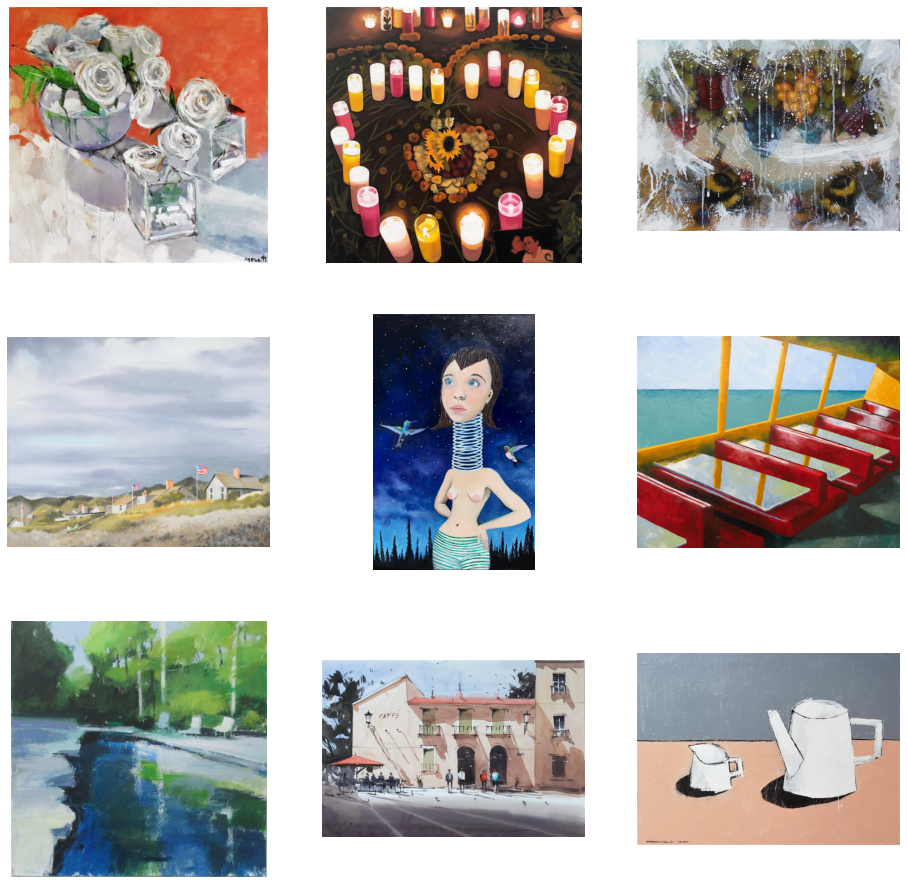

In [206]:
# E = 2.7182818
# E^2 = 7.38905609
my_score = np.zeros(len(flt_data))

idx_list = get_random_idx(my_score, 7.38905609)
view_image(idx_list, file_names, 3)

In [230]:
val_list = list(map(int, input().split()))
my_score = get_new_score_softmax(score, my_score, idx_list,val_list, 30)
print(my_score[:20])

0 0 0 1 0 0 1 0 0
[0.2346878386140503, 0.30808388972889084, 0.42528995394047897, 0.5273651798778767, 0.39510533416238414, 0.33198936766603154, 0.38951339745425045, 0.36809987590939186, 0.2540553290394624, 0.41679521592835916, 0.47352462492708103, 0.49680637595839416, 0.32728148601072293, 0.38011924108930145, 0.3764165373274448, 0.18345427292386032, 0.15728299865287068, 0.315095362752072, 0.39410317114273613, 0.35503809446680507]


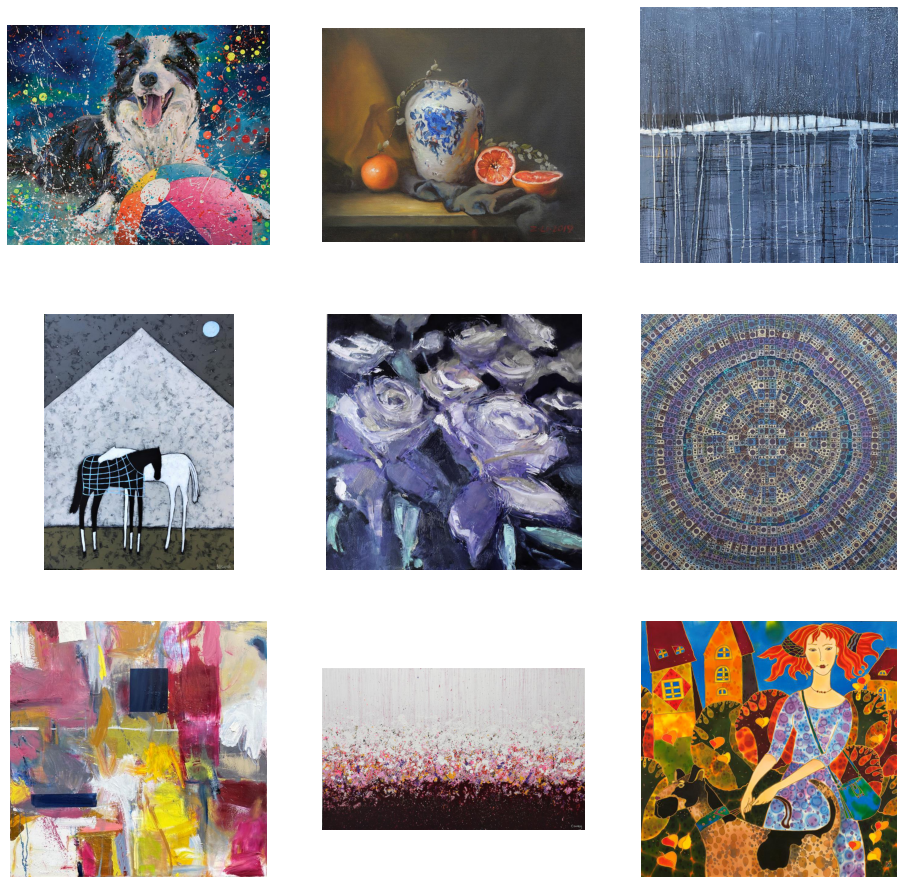

In [234]:
idx_list = get_random_idx(my_score, 7.38905609)
view_image(idx_list, file_names, 3)

In [235]:
val_list = list(map(int, input().split()))
my_score = get_new_score_softmax(score, my_score, idx_list,val_list, 30)
print(my_score[:20])

0 1 1 0 0 0 0 0 0
[0.30192096 0.35965742 0.42753857 0.56425244 0.47784082 0.43520771
 0.39989519 0.42328056 0.3157299  0.50515001 0.56360105 0.56534019
 0.34389959 0.42667994 0.37641654 0.24032891 0.2495519  0.31509536
 0.45930634 0.40624048]


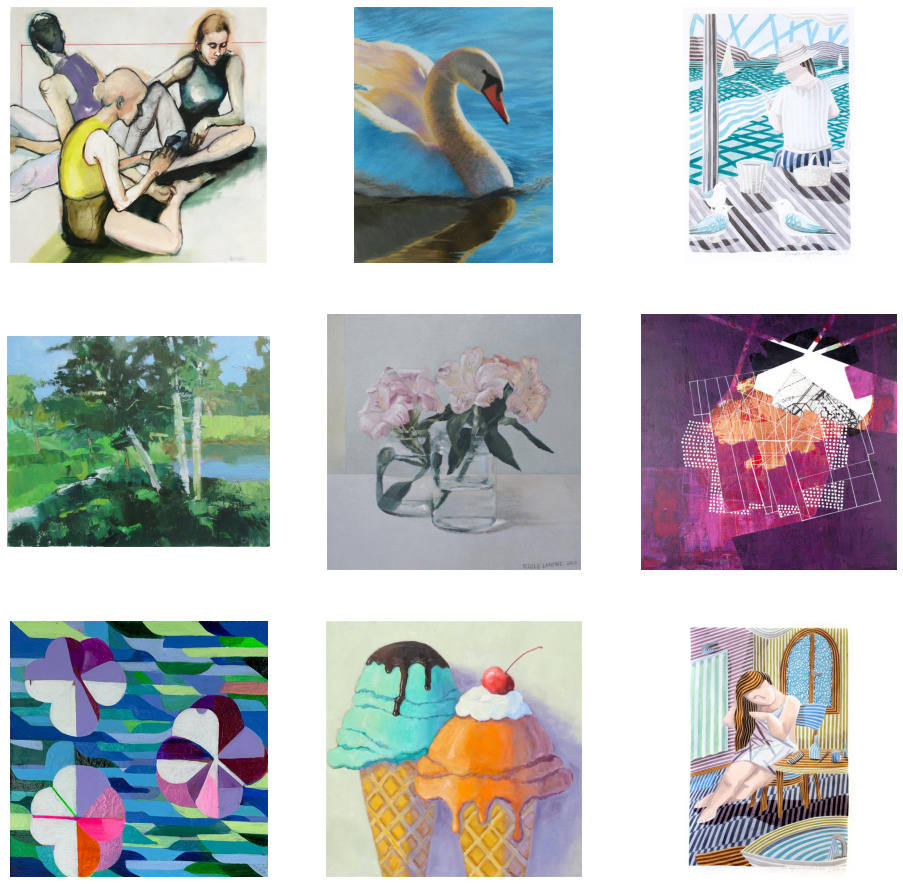

In [236]:
idx_list = get_random_idx(my_score, 7.38905609)
view_image(idx_list, file_names, 3)

In [237]:
val_list = list(map(int, input().split()))
my_score = get_new_score_softmax(score, my_score, idx_list,val_list, 30)
print(my_score[:20])

0 1 0 1 1 0 0 0 0
[0.38064298 0.40478607 0.46005254 0.56425244 0.47784082 0.43520771
 0.39989519 0.42328056 0.3157299  0.50515001 0.56360105 0.58753039
 0.41110273 0.42667994 0.45448021 0.24032891 0.2495519  0.4227347
 0.54176124 0.45609595]


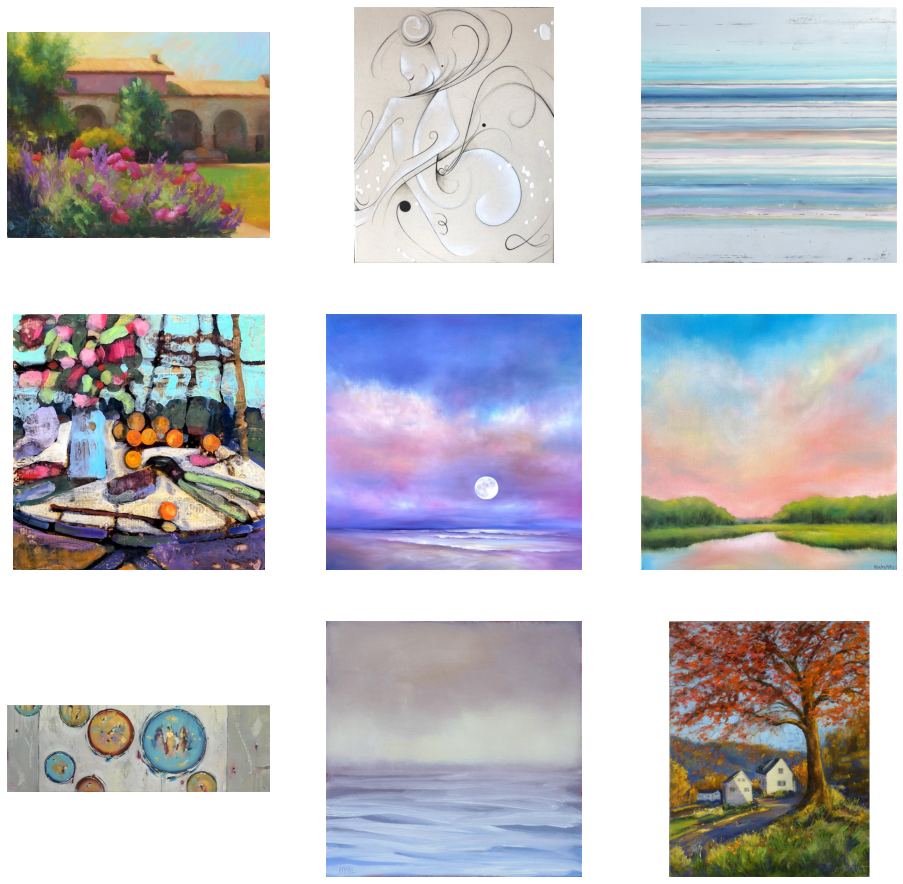

In [238]:
idx_list = get_random_idx(my_score, 7.38905609)
view_image(idx_list, file_names, 3)

In [239]:
val_list = list(map(int, input().split()))
my_score = get_new_score_softmax(score, my_score, idx_list,val_list, 30)
print(my_score[:20])

1 0 1 0 1 1 0 1 1
[0.38064298 0.40478607 0.46005254 0.56425244 0.47784082 0.43520771
 0.39989519 0.42328056 0.3157299  0.50515001 0.56360105 0.58753039
 0.41110273 0.42667994 0.45448021 0.24032891 0.2495519  0.4227347
 0.54176124 0.45609595]


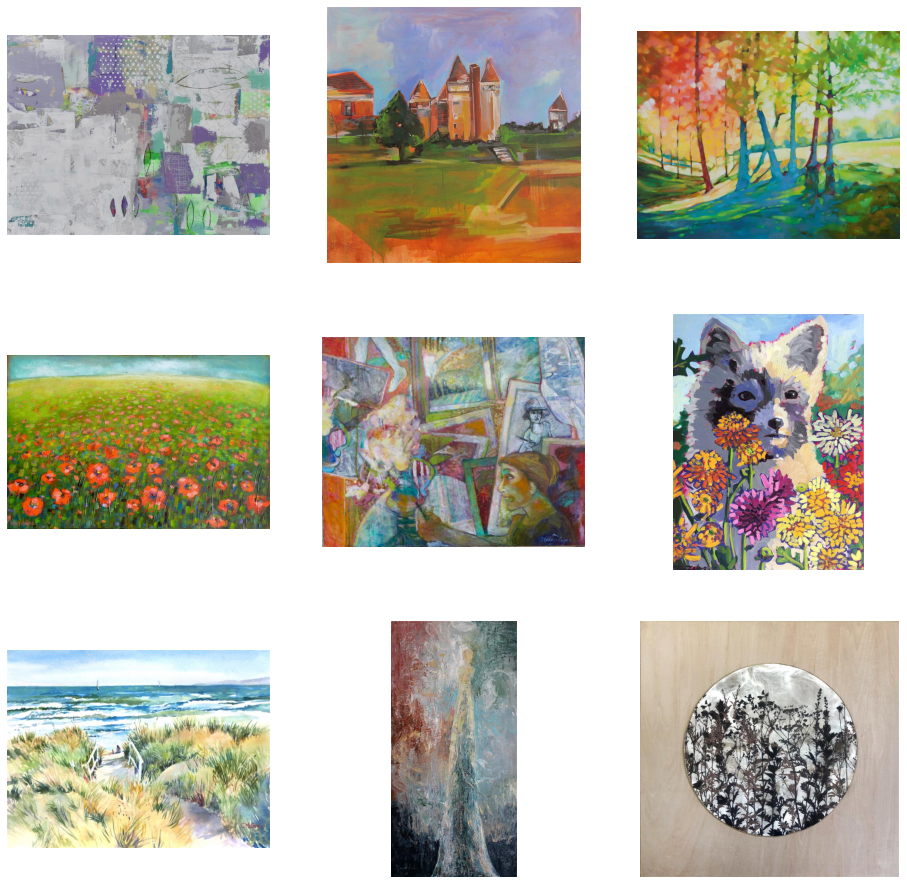

In [240]:
idx_list = get_random_idx(my_score, 7.38905609)
view_image(idx_list, file_names, 3)

In [241]:
val_list = list(map(int, input().split()))
my_score = get_new_score_softmax(score, my_score, idx_list,val_list, 30)
print(my_score[:20])

0 1 1 1 0 0 1 0 0
[0.38064298 0.40478607 0.46005254 0.56425244 0.47784082 0.43520771
 0.39989519 0.42328056 0.34132177 0.50515001 0.56360105 0.58753039
 0.43094986 0.42667994 0.45448021 0.24032891 0.2495519  0.4227347
 0.54176124 0.45609595]


<AxesSubplot:ylabel='Count'>

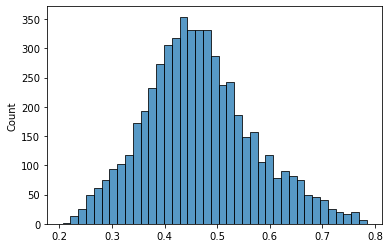

In [265]:
sns.histplot(my_score)

[0.75784849 0.75821435 0.75921058 0.76010869 0.76090127 0.76145853
 0.76192119 0.76294131 0.76334552 0.76443983 0.76458132 0.7652608
 0.76540696 0.76739116 0.76741134 0.76806523 0.76821036 0.7696506
 0.76998541 0.77043063 0.77215623 0.77325165 0.77331613 0.77782298
 0.78453313]


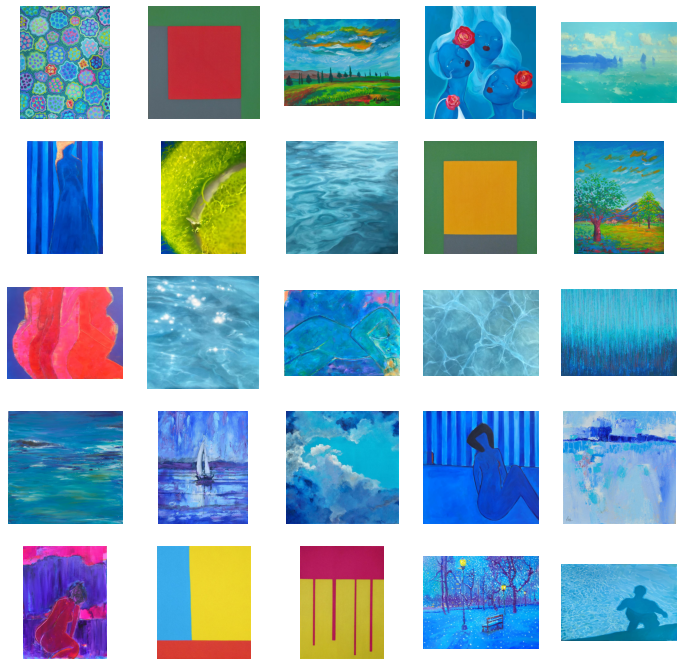

In [269]:
top25 = sorted(range(len(my_score)), key= lambda i: my_score[i])[-25:]
print(my_score[top25])
view_image(top25, file_names, 5)

[0.20589359 0.22181828 0.22256827 0.22262407 0.22455607 0.22616799
 0.22657461 0.22810316 0.2317782  0.2326364  0.23327414 0.23390027
 0.23478463 0.23511142 0.23560825 0.23579973 0.23635164 0.23861595
 0.24008813 0.24032891 0.24070485 0.24087846 0.24101731 0.24141422
 0.24403765]


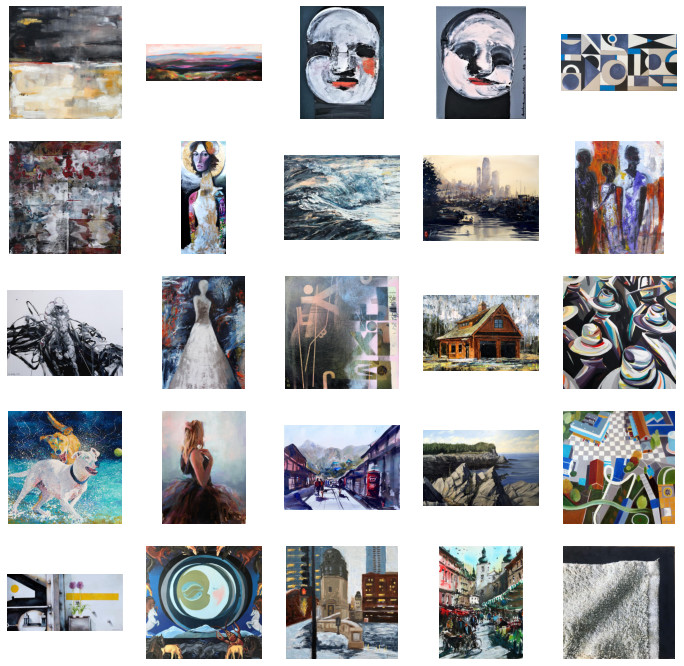

In [271]:
under25 = sorted(range(len(my_score)), key= lambda i: my_score[i])[:25]
print(my_score[under25])
view_image(under25, file_names, 5)

# Case2. Scoring by linearmax

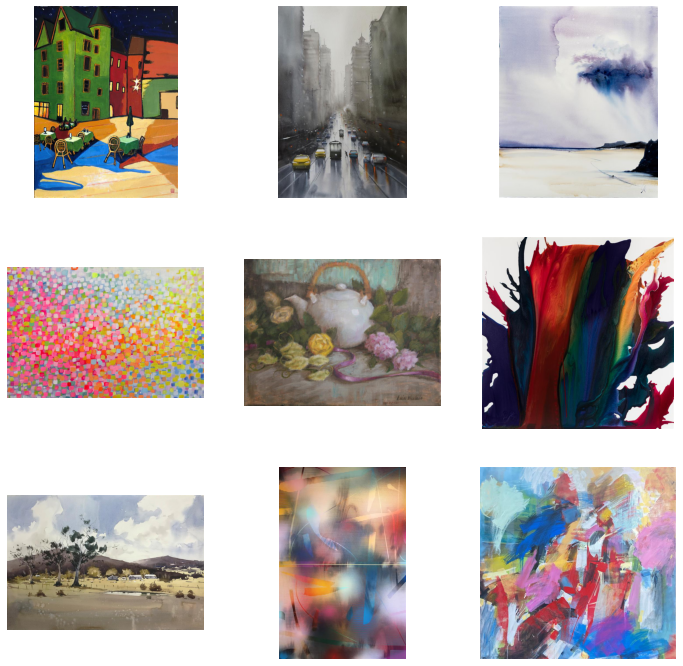

In [283]:
# E = 2.7182818
# E^2 = 7.38905609
my_score_2 = np.zeros(len(flt_data))

idx_list = get_random_idx(my_score_2, 7.38905609)
view_image(idx_list, file_names, 3)

In [285]:
val_list = list(map(int, input().split()))
my_score_2 = get_new_score_linearmax(score, my_score_2, idx_list, val_list)
print(my_score_2[:10])

0 1 1 0 0 0 1 0 0
[0.54905385 0.43911494 0.27649854 0.64240933 0.66827457 0.50096335
 0.73009289 0.4268525  0.66775136 0.35784734]


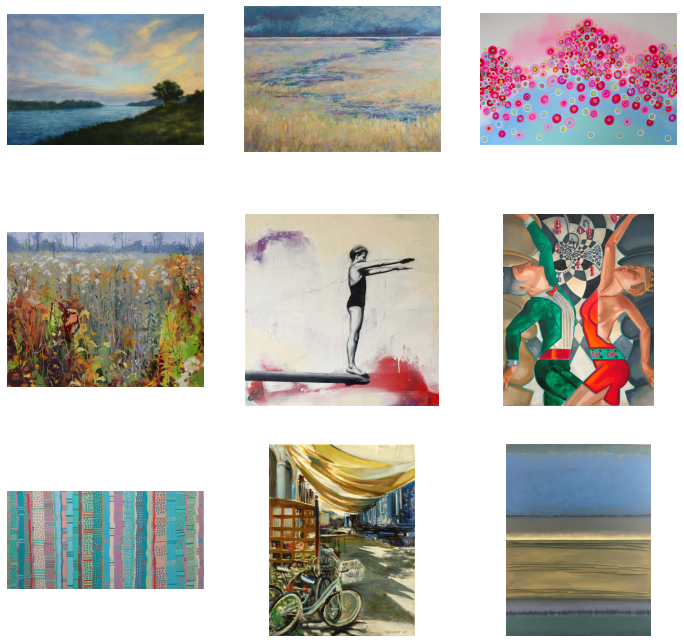

In [286]:
idx_list = get_random_idx(my_score_2, 7.38905609)
view_image(idx_list, file_names, 3)

In [287]:
val_list = list(map(int, input().split()))
my_score_2 = get_new_score_linearmax(score, my_score_2, idx_list, val_list)
print(my_score_2[:10])

1 1 0 1 1 0 0 1 0
[0.54905385 0.7426751  0.72267915 0.64240933 0.66827457 0.51255161
 0.73009289 0.61153426 0.66775136 0.42761487]


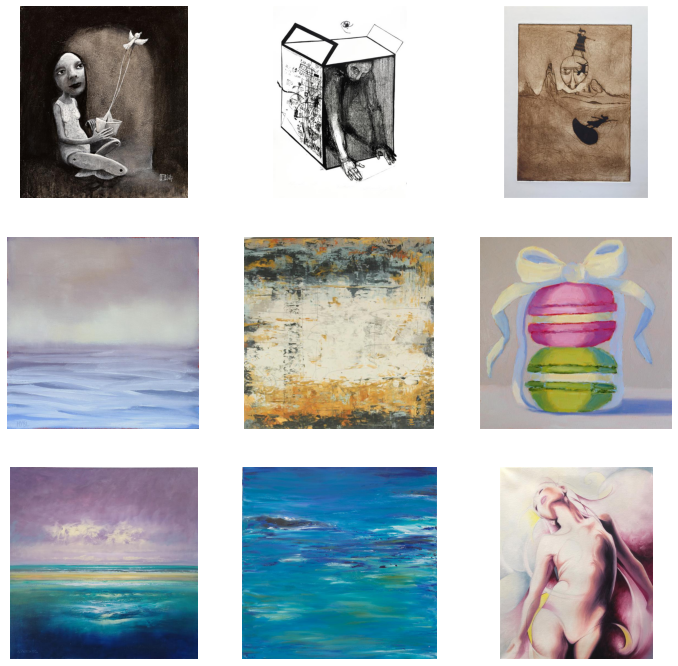

In [288]:
idx_list = get_random_idx(my_score_2, 7.38905609)
view_image(idx_list, file_names, 3)

In [289]:
val_list = list(map(int, input().split()))
my_score_2 = get_new_score_linearmax(score, my_score_2, idx_list, val_list)
print(my_score_2[:10])

0 0 0 1 0 0 1 1 0
[0.54905385 0.7426751  0.72267915 0.64240933 0.66827457 0.51255161
 0.73009289 0.67240318 0.66775136 0.86832433]


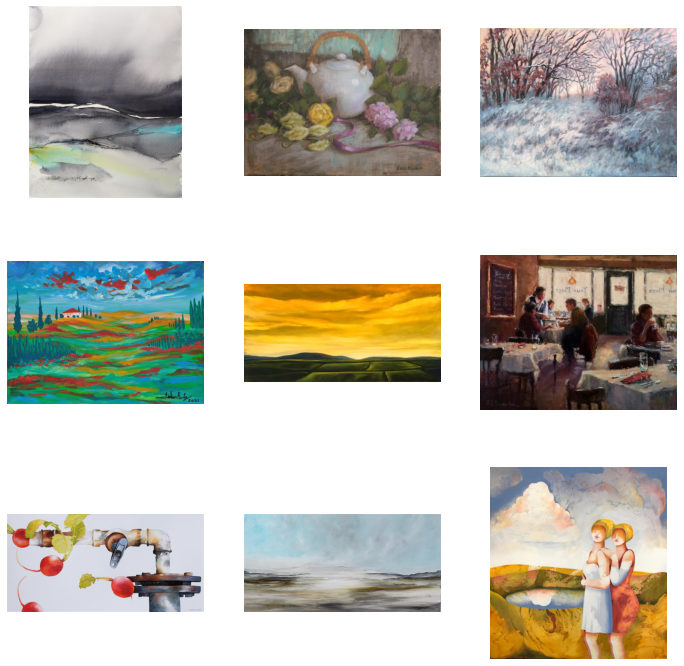

In [290]:
idx_list = get_random_idx(my_score_2, 7.38905609)
view_image(idx_list, file_names, 3)

In [291]:
val_list = list(map(int, input().split()))
my_score_2 = get_new_score_linearmax(score, my_score_2, idx_list, val_list)
print(my_score_2[:10])

0 1 1 0 0 1 0 1 0
[0.6901514  0.7426751  0.72267915 0.64240933 0.66827457 0.51255161
 0.73209018 0.70899643 0.66775136 0.86832433]


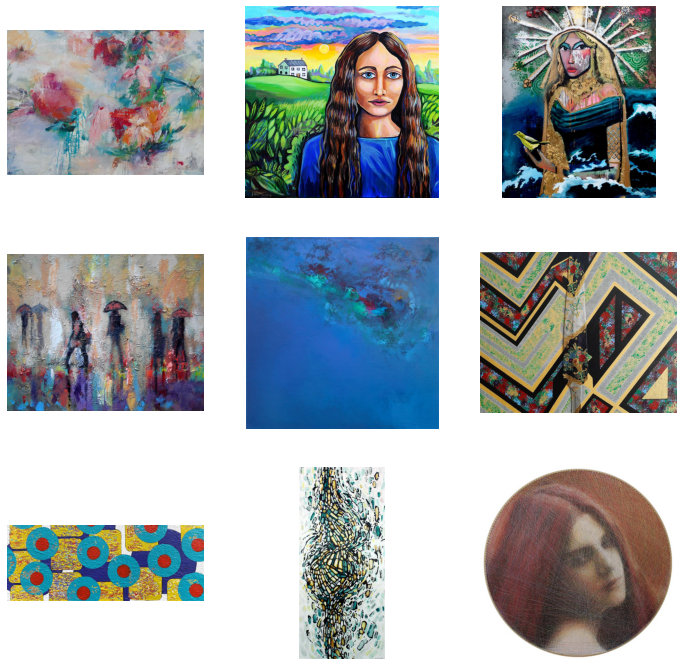

In [292]:
idx_list = get_random_idx(my_score_2, 7.38905609)
view_image(idx_list, file_names, 3)

In [293]:
val_list = list(map(int, input().split()))
my_score_2 = get_new_score_linearmax(score, my_score_2, idx_list, val_list)
print(my_score_2[:10])

1 0 0 0 0 0 0 0 0
[0.6901514  0.7426751  0.72267915 0.64240933 0.66827457 0.51255161
 0.75493507 0.74495011 0.66775136 0.95597747]


<AxesSubplot:ylabel='Count'>

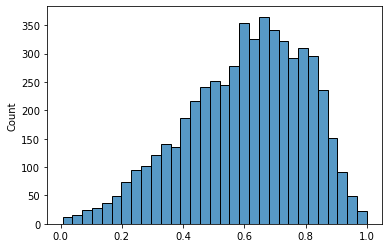

In [318]:
sns.histplot(my_score_2)

[0.96317723 0.96597887 0.96822911 0.96913137 0.97027007 0.97076608
 0.97121251 0.97395118 0.98061099 1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.        ]


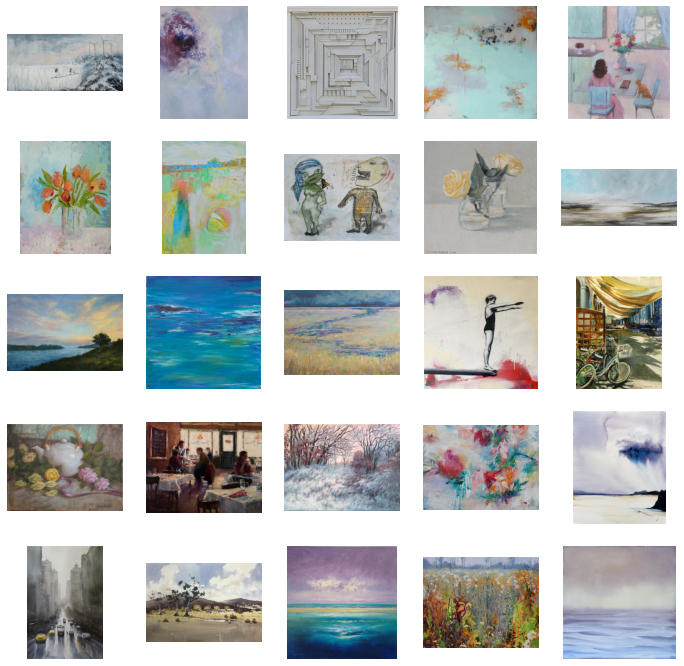

In [319]:
top25 = sorted(range(len(my_score_2)), key= lambda i: my_score_2[i])[-25:]
print(my_score_2[top25])
view_image(top25, file_names, 5)

[0.0063335  0.00894959 0.01507287 0.01903135 0.02127282 0.02360713
 0.02785098 0.03467648 0.03621245 0.03766839 0.03800924 0.03824084
 0.04127694 0.04264907 0.04326388 0.05264047 0.05542387 0.05559554
 0.05794352 0.05809586 0.05906763 0.05920735 0.06072182 0.06440142
 0.06444621]


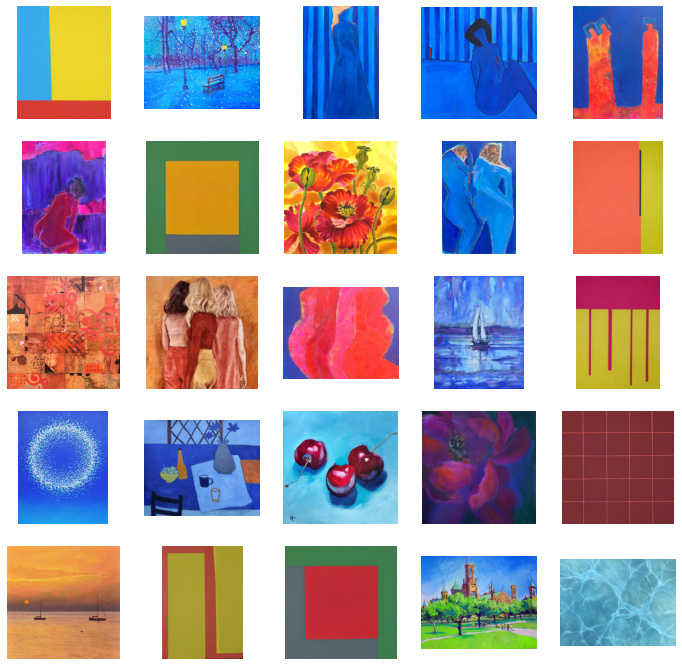

In [321]:
under25 = sorted(range(len(my_score_2)), key= lambda i: my_score_2[i])[:25]
print(my_score_2[under25])
view_image(under25, file_names, 5)

# Case3. Scoring by crossmax

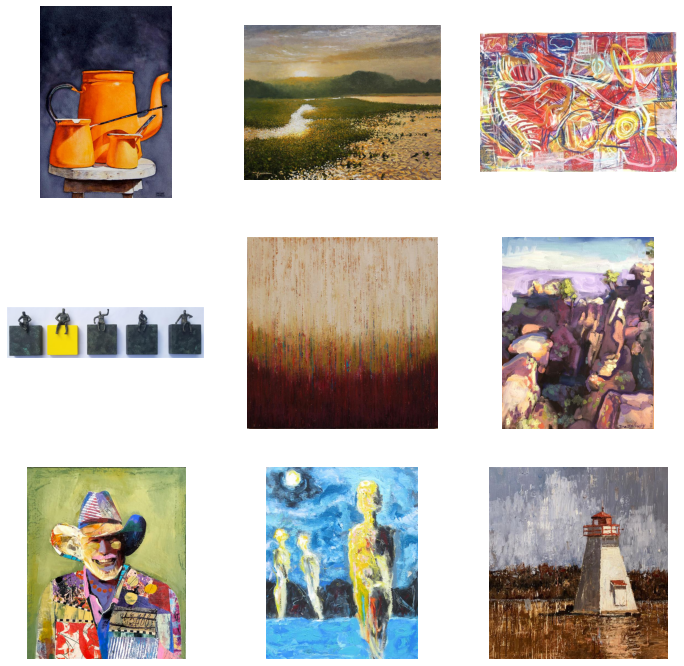

In [307]:
my_score_3 = np.zeros(len(flt_data))
my_rscore_3 = np.zeros(len(flt_data))

idx_list = get_random_idx_cross(my_score_3, my_rscore_3, 7.38905609)
view_image(idx_list, file_names, 3)

In [309]:
val_list = list(map(int, input().split()))
my_score_3, my_rscore_3 = get_new_score_crossmax(score, my_score_3, my_rscore_3, idx_list, val_list)
print(my_score_3[:10])
print(my_rscore_3[:10])

0 1 0 0 0 0 0 1 0
[0.28300175 0.40824112 0.38712448 0.13135919 0.17121374 0.13510439
 0.23838699 0.1559291  0.29274413 0.05650076]


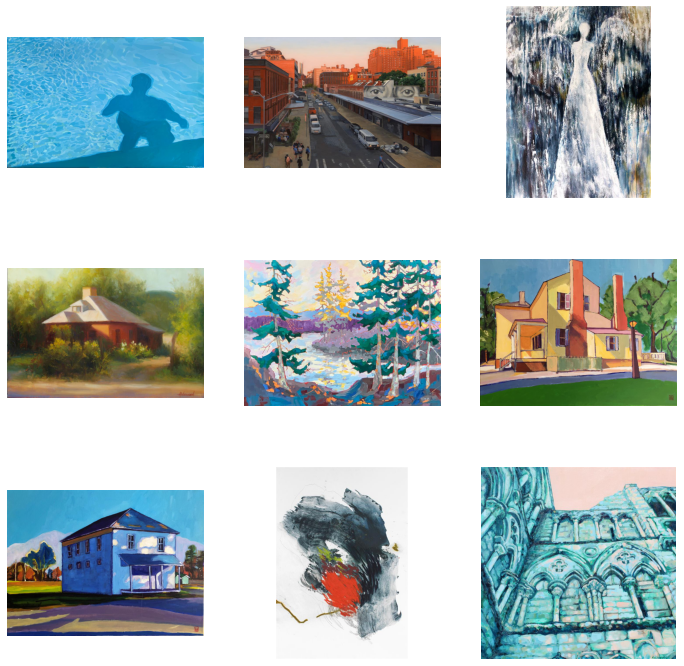

In [310]:
idx_list = get_random_idx_cross(my_score_3, my_rscore_3, 7.38905609)
view_image(idx_list, file_names, 3)

In [311]:
val_list = list(map(int, input().split()))
my_score_3, my_rscore_3 = get_new_score_crossmax(score, my_score_3, my_rscore_3, idx_list, val_list)
print(my_score_3[:10])
print(my_rscore_3[:10])

1 0 0 1 1 0 0 0 0
[0.28300175 0.40824112 0.38712448 0.13135919 0.17121374 0.3792616
 0.23838699 0.1559291  0.50742877 0.05650076] [0.61890447 0.850832   0.80637784 0.52384595 0.39993283 0.48461539
 0.64949666 0.76897812 0.61045408 0.5935717 ]


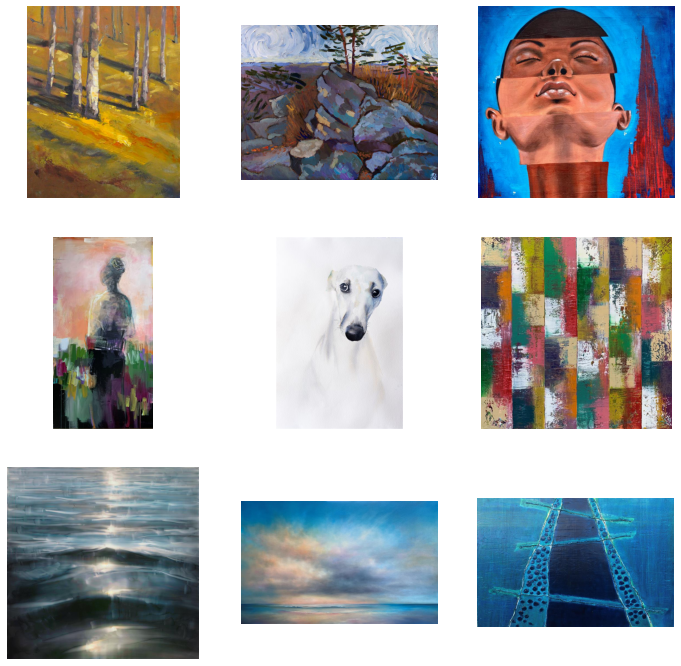

In [312]:
idx_list = get_random_idx_cross(my_score_3, my_rscore_3, 7.38905609)
view_image(idx_list, file_names, 3)

In [313]:
val_list = list(map(int, input().split()))
my_score_3, my_rscore_3 = get_new_score_crossmax(score, my_score_3, my_rscore_3, idx_list, val_list)
print(my_score_3[:10])
print(my_rscore_3[:10])

1 0 0 1 0 0 0 1 0
[0.49271334 0.65725225 0.68219729 0.23722931 0.17121374 0.3792616
 0.46605653 0.29241446 0.50742877 0.13905088]
[0.63176785 0.850832   0.80637784 0.56219352 0.539457   0.48461539
 0.74709315 0.76897812 0.6309551  0.5935717 ]


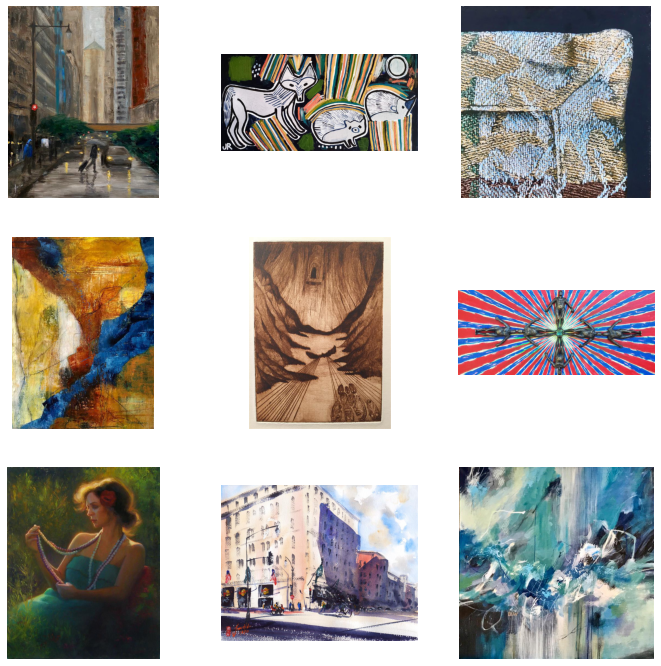

In [314]:
idx_list = get_random_idx_cross(my_score_3, my_rscore_3, 7.38905609)
view_image(idx_list, file_names, 3)

In [315]:
val_list = list(map(int, input().split()))
my_score_3, my_rscore_3 = get_new_score_crossmax(score, my_score_3, my_rscore_3, idx_list, val_list)
print(my_score_3[:10])
print(my_rscore_3[:10])

1 0 0 0 0 0 1 1 0
[0.59969673 0.65725225 0.68219729 0.28448044 0.43854241 0.44136908
 0.58467245 0.29241446 0.61591605 0.13905088]
[0.63176785 0.850832   0.80637784 0.56219352 0.539457   0.48461539
 0.74709315 0.76897812 0.6309551  0.59380093]


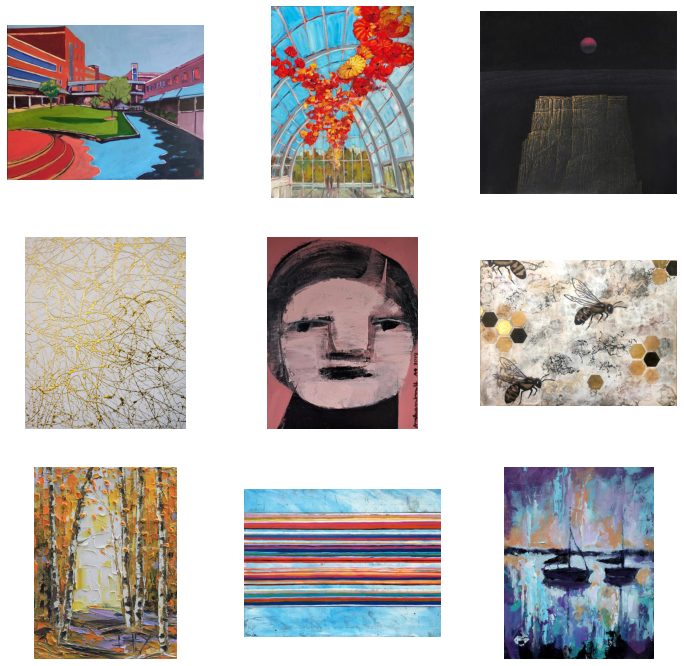

In [316]:
idx_list = get_random_idx_cross(my_score_3, my_rscore_3, 7.38905609)
view_image(idx_list, file_names, 3)

In [317]:
val_list = list(map(int, input().split()))
my_score_3, my_rscore_3 = get_new_score_crossmax(score, my_score_3, my_rscore_3, idx_list, val_list)
print(my_score_3[:10])
print(my_rscore_3[:10])

0 1 0 0 0 0 0 0 0
[0.59969673 0.65725225 0.68219729 0.28448044 0.43854241 0.44136908
 0.58467245 0.29241446 0.61591605 0.1444496 ]
[0.8758055  0.850832   0.80637784 0.56219352 0.539457   0.55993355
 0.74709315 0.76897812 0.68403846 0.77444545]


<AxesSubplot:ylabel='Count'>

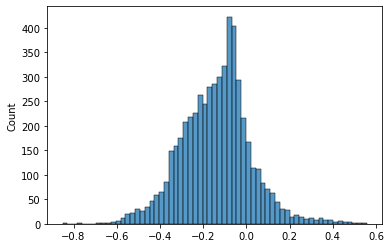

In [325]:
sns.histplot(my_score_3 - my_rscore_3)

[0.39042554 0.39114518 0.39454389 0.3975559  0.39818057 0.41033083
 0.41276264 0.42063728 0.43070461 0.43148297 0.43191065 0.43793832
 0.44134288 0.44183146 0.44654536 0.4509721  0.45099367 0.46898679
 0.47452301 0.4800666  0.48334311 0.49094533 0.49803671 0.51380824
 0.55804218]


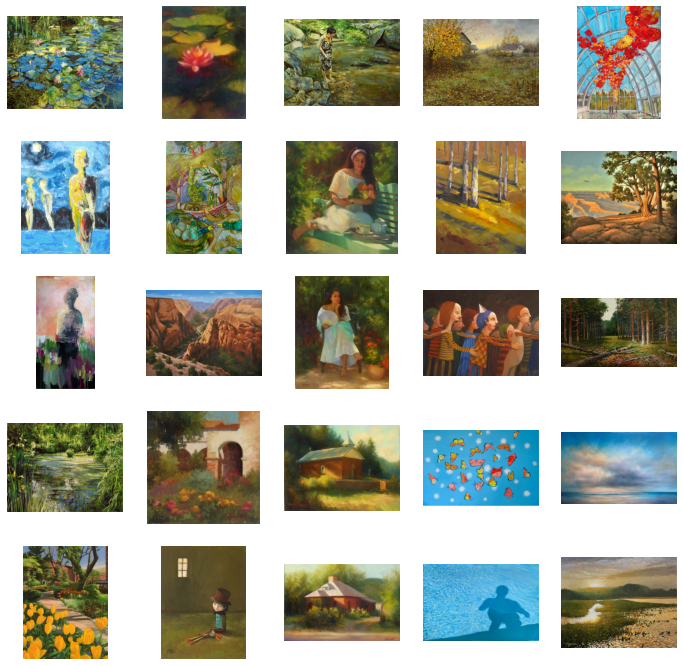

In [323]:
top25 = sorted(range(len(my_score_3)), key= lambda i: my_score_3[i] - my_rscore_3[i])[-25:]
print(my_score_3[top25] - my_rscore_3[top25])
view_image(top25, file_names, 5)

[-0.85100897 -0.77613628 -0.68898491 -0.68816685 -0.65813625 -0.62999585
 -0.62279772 -0.60935656 -0.60520127 -0.59562393 -0.59532056 -0.59494495
 -0.59238104 -0.59104821 -0.58743596 -0.57621645 -0.57277466 -0.57089347
 -0.56985142 -0.56966919 -0.56855451 -0.56735785 -0.56598617 -0.5655177
 -0.56176631]


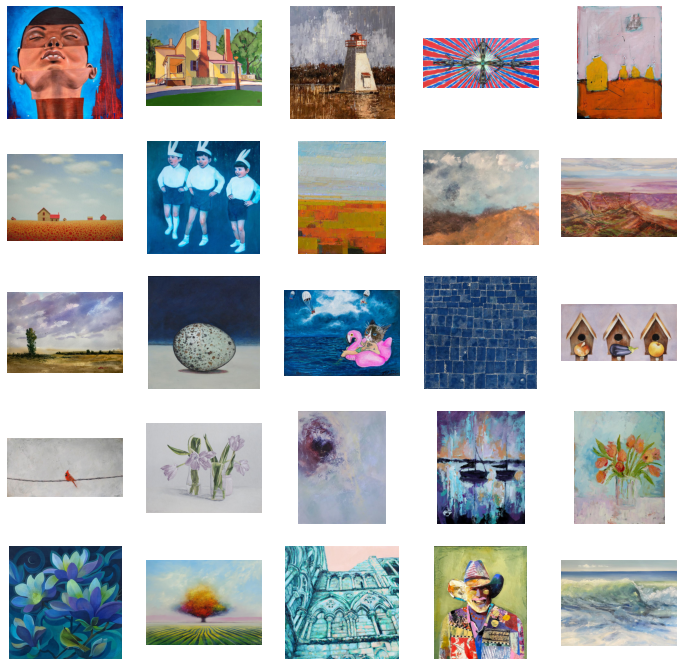

In [324]:
under25 = sorted(range(len(my_score_3)), key= lambda i: my_score_3[i] - my_rscore_3[i])[:25]
print(my_score_3[under25] - my_rscore_3[under25])
view_image(under25, file_names, 5)

# Case4. Scoring by crossexp

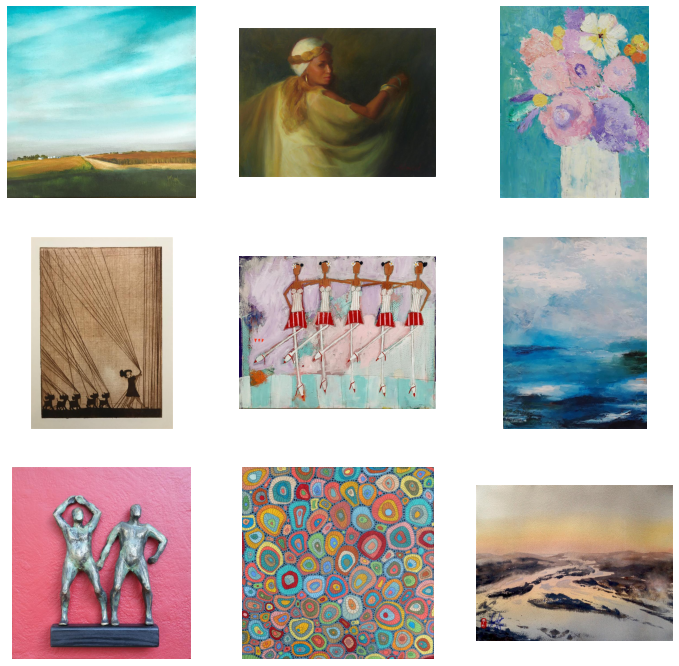

In [355]:
my_score_4 = np.zeros(len(flt_data))
my_rscore_4 = np.zeros(len(flt_data))

idx_list = get_random_idx_cross(my_score_4, my_rscore_4, 7.38905609)
view_image(idx_list, file_names, 3)

In [371]:
val_list = list(map(int, input().split()))
my_score_4, my_rscore_4 = get_new_score_crossexp(score, my_score_4, my_rscore_4, idx_list, val_list, 2)
print(my_score_4[:10])
print(my_rscore_4[:10])

1 1 0 0 0 1 0 0 0
[0.47917857 0.26962368 0.17092904 0.03437589 0.07412105 0.25393616
 0.31378936 0.31453391 0.15162102 0.46599889]
[0.28491973 0.51405162 0.50451409 0.22690434 0.18556001 0.24047898
 0.44168589 0.39102582 0.39692794 0.41183307]


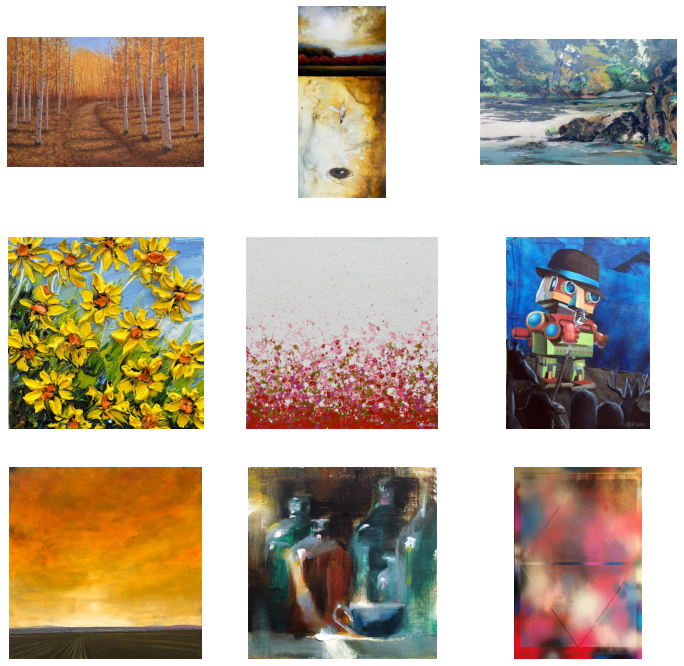

In [372]:
idx_list = get_random_idx_cross(my_score_4, my_rscore_4, 7.38905609)
view_image(idx_list, file_names, 3)

In [373]:
val_list = list(map(int, input().split()))
my_score_4, my_rscore_4 = get_new_score_crossexp(score, my_score_4, my_rscore_4, idx_list, val_list, 2)
print(my_score_4[:10])
print(my_rscore_4[:10])

1 0 1 0 0 0 1 0 0
[0.47917857 0.26962368 0.17637231 0.3644713  0.28700813 0.25393616
 0.34218806 0.31453391 0.2099554  0.46599889]
[0.57369489 0.51405162 0.50451409 0.22690434 0.23994442 0.39715777
 0.44168589 0.39102582 0.43932718 0.41183307]


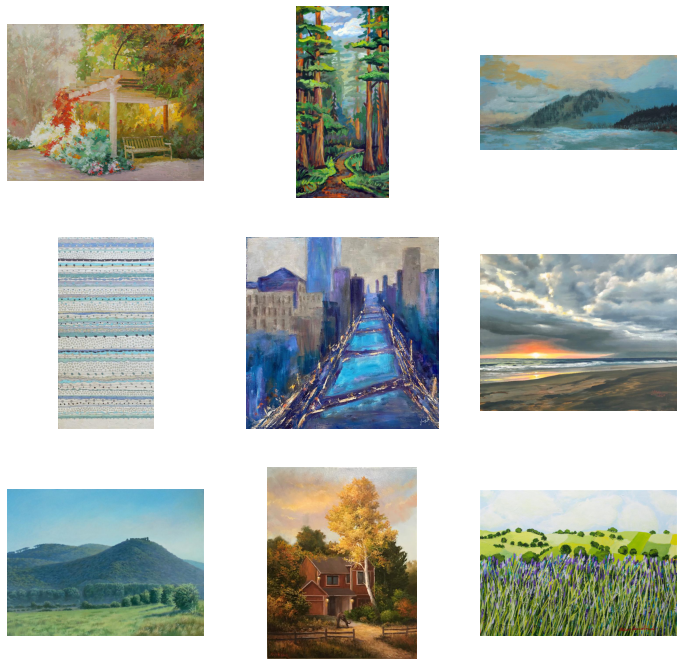

In [374]:
idx_list = get_random_idx_cross(my_score_4, my_rscore_4, 7.38905609)
view_image(idx_list, file_names, 3)

In [375]:
val_list = list(map(int, input().split()))
my_score_4, my_rscore_4 = get_new_score_crossexp(score, my_score_4, my_rscore_4, idx_list, val_list, 2)
print(my_score_4[:10])
print(my_rscore_4[:10])

1 0 1 0 0 1 1 1 0
[0.47917857 0.53704489 0.5352914  0.3644713  0.31742061 0.29932847
 0.63054619 0.438541   0.34315945 0.4815836 ]
[0.57369489 0.51405162 0.50451409 0.2718354  0.31633631 0.46283194
 0.44168589 0.39102582 0.43932718 0.4360427 ]


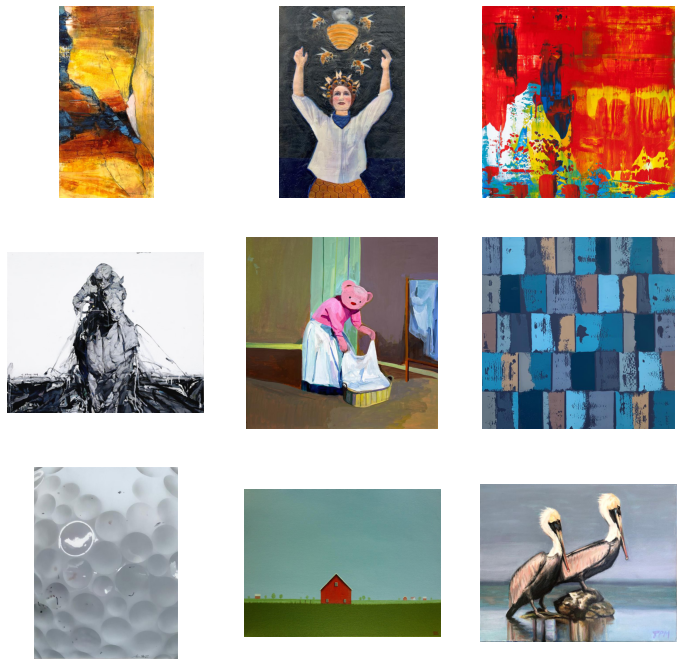

In [376]:
idx_list = get_random_idx_cross(my_score_4, my_rscore_4, 7.38905609)
view_image(idx_list, file_names, 3)

In [377]:
val_list = list(map(int, input().split()))
my_score_4, my_rscore_4 = get_new_score_crossexp(score, my_score_4, my_rscore_4, idx_list, val_list, 2)
print(my_score_4[:10])
print(my_rscore_4[:10])

0 0 0 0 0 0 0 0 1
[0.47917857 0.53704489 0.5352914  0.3644713  0.31742061 0.29932847
 0.63054619 0.70842205 0.34315945 0.4815836 ]
[0.57369489 0.51405162 0.50451409 0.51218047 0.37424281 0.46283194
 0.51588528 0.5766639  0.43932718 0.49665071]


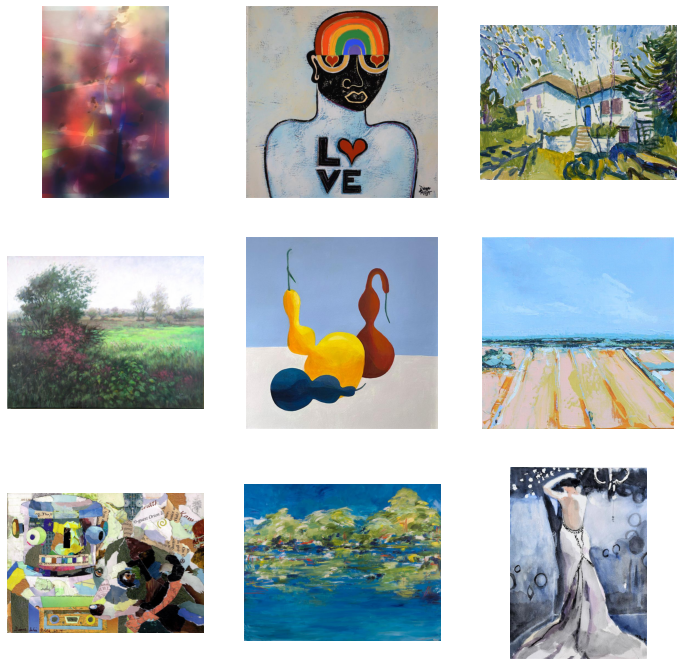

In [378]:
idx_list = get_random_idx_cross(my_score_4, my_rscore_4, 7.38905609)
view_image(idx_list, file_names, 3)

In [379]:
val_list = list(map(int, input().split()))
my_score_4, my_rscore_4 = get_new_score_crossexp(score, my_score_4, my_rscore_4, idx_list, val_list, 2)
print(my_score_4[:10])
print(my_rscore_4[:10])

0 0 0 1 0 1 0 0 0
[0.47917857 0.53704489 0.5352914  0.3644713  0.31742061 0.38584147
 0.63054619 0.70842205 0.35735976 0.4815836 ]
[0.57369489 0.51405162 0.50451409 0.51218047 0.37424281 0.46283194
 0.51588528 0.58178341 0.66036189 0.63897039]


<AxesSubplot:ylabel='Count'>

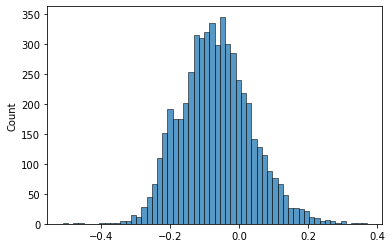

In [380]:
sns.histplot(my_score_4 - my_rscore_4)

[0.23861908 0.24039433 0.24055707 0.2469561  0.25332755 0.25395222
 0.25623535 0.25657792 0.25673725 0.26209994 0.26309646 0.26662908
 0.26669224 0.27353764 0.27846763 0.29054596 0.29526317 0.29928657
 0.30084368 0.30945279 0.33696281 0.33873781 0.34805365 0.35243765
 0.37060927]


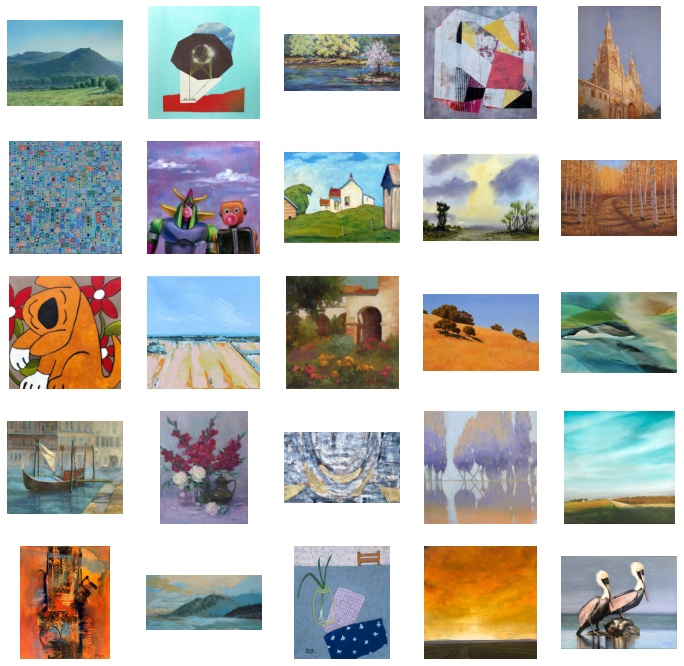

In [382]:
top25 = sorted(range(len(my_score_4)), key= lambda i: my_score_4[i] - my_rscore_4[i])[-25:]
print(my_score_4[top25] - my_rscore_4[top25])
view_image(top25, file_names, 5)

[-0.51070753 -0.46826095 -0.45351546 -0.39775942 -0.38167262 -0.36287711
 -0.35904634 -0.35329762 -0.34113533 -0.34017516 -0.33693904 -0.33688182
 -0.33529699 -0.32528048 -0.32101096 -0.31716667 -0.31362858 -0.31137035
 -0.30722611 -0.30643735 -0.30572192 -0.30552891 -0.30429476 -0.30300213
 -0.30157712]


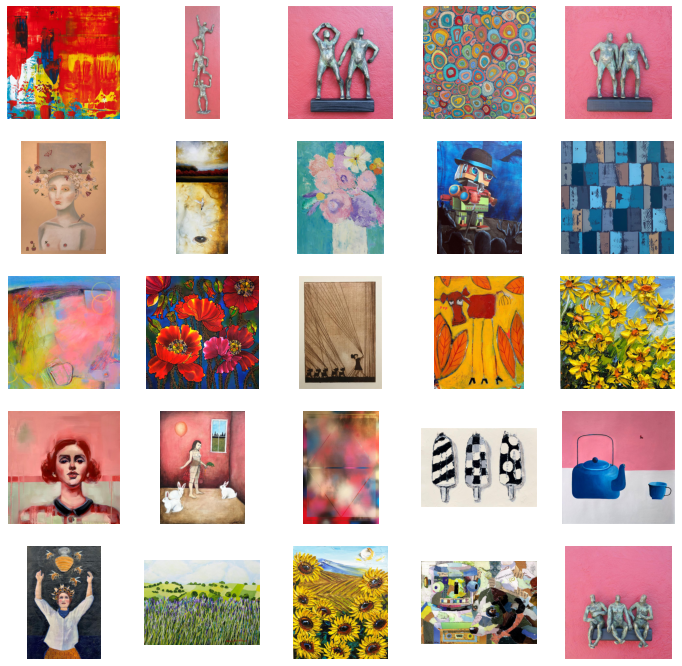

In [383]:
under25 = sorted(range(len(my_score_3)), key= lambda i: my_score_4[i] - my_rscore_4[i])[:25]
print(my_score_4[under25] - my_rscore_4[under25])
view_image(under25, file_names, 5)